<script>
    setBackgroundImage("C:/Users/AN/Pictures/ev_D01_002.jpg", "white");
</script>

In [1]:
!nvidia-smi

Thu Jul 13 18:55:43 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA A100-SXM...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   34C    P0    46W / 400W |      0MiB / 40960MiB |      0%      Default |
|                               |                      |             Disabled |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [1]:
!pip install diffusers accelerate scipy safetensors omegaconf peft
!pip install bitsandbytes loralib datasets
!pip install xformers torchsummary
!pip install -U git+https://github.com/huggingface/transformers@de9255de27abfcae4a1f816b904915f0b1e23cd9

     ---------------------------------------- 1.2/1.2 MB 2.4 MB/s eta 0:00:00
     -------------------------------------- 244.2/244.2 kB 7.5 MB/s eta 0:00:00
     ---------------------------------------- 44.0/44.0 MB 6.5 MB/s eta 0:00:00
     -------------------------------------- 263.7/263.7 kB 8.2 MB/s eta 0:00:00
     ---------------------------------------- 79.5/79.5 kB 2.2 MB/s eta 0:00:00
     ---------------------------------------- 56.8/56.8 kB 2.9 MB/s eta 0:00:00
     -------------------------------------- 172.3/172.3 MB 4.1 MB/s eta 0:00:00
     ---------------------------------------- 2.5/2.5 MB 7.0 MB/s eta 0:00:00
     ------------------------------------ 268.8/268.8 kB 635.4 kB/s eta 0:00:00
     ---------------------------------------- 15.0/15.0 MB 7.8 MB/s eta 0:00:00
     -------------------------------------- 268.0/268.0 kB 8.3 MB/s eta 0:00:00
  Using cached requests-2.31.0-py3-none-any.whl (62 kB)
     -------------------------------------- 151.7/151.7 kB 9.4 MB/s 

  Running command git clone --filter=blob:none --quiet https://github.com/huggingface/transformers 'C:\Users\AN\AppData\Local\Temp\pip-req-build-m8l7gl3l'
  Running command git rev-parse -q --verify 'sha^de9255de27abfcae4a1f816b904915f0b1e23cd9'
  Running command git fetch -q https://github.com/huggingface/transformers de9255de27abfcae4a1f816b904915f0b1e23cd9
  Running command git checkout -q de9255de27abfcae4a1f816b904915f0b1e23cd9


In [2]:
from google.colab import drive
drive.mount('/content/drive')
%cd /content/drive/MyDrive/Stable_diffusion

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
/content/drive/MyDrive/Stable_diffusion


In [ ]:
# url = "https://raw.githubusercontent.com/huggingface/diffusers/main/scripts/convert_original_stable_diffusion_to_diffusers.py"
# file_name = "/content/drive/MyDrive/Stable_diffusion/convert_original_stable_diffusion_to_diffusers.py"

# response = requests.get(url)
# response.raise_for_status()

# with open(file_name, "wb") as file:
#     file.write(response.content)

# print("Tải tệp dữ liệu thành công!")

In [ ]:
# url = "https://civitai.com/api/download/models/57618"
# file_name = "Counterfeit-V3.0-fp16"

# response = requests.get(url)
# response.raise_for_status()

# with open(file_name, "wb") as file:
#     file.write(response.content)

# print("Tải tệp dữ liệu thành công!")

In [ ]:
checkpoint_path = '/content/drive/MyDrive/Stable_diffusion/Counterfeit-V3.0-fp16'

In [ ]:
# !mkdir converted
## https://github.com/huggingface/diffusers/blob/main/scripts/convert_original_stable_diffusion_to_diffusers.py
# !python convert_original_stable_diffusion_to_diffusers.py --checkpoint_path /content/drive/MyDrive/Stable_diffusion/Counterfeit-V3.0-fp16 --from_safetensors --dump_path converted

In [12]:
!pip install matplotlib

     ---------------------------------------- 7.5/7.5 MB 6.4 MB/s eta 0:00:00
     -------------------------------------- 470.4/470.4 kB 7.4 MB/s eta 0:00:00
  Using cached cycler-0.11.0-py3-none-any.whl (6.4 kB)
     ---------------------------------------- 2.0/2.0 MB 8.9 MB/s eta 0:00:00
     ---------------------------------------- 55.3/55.3 kB 3.0 MB/s eta 0:00:00
  Using cached pyparsing-3.0.9-py3-none-any.whl (98 kB)


In [2]:
import torch

In [5]:
tensor = torch.Tensor([1])
tensor

tensor([1.])

In [13]:
import cv2
import PIL
import os
import random
import math
import argparse
import torch.nn.functional as F
import torch.utils.checkpoint as ckpt
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import numpy as np
from diffusers.utils import load_image
from diffusers.loaders import AttnProcsLayers

import torch
import requests
import glob

from accelerate import Accelerator
from accelerate.logging import get_logger
from accelerate.utils import set_seed
from diffusers import(
     StableDiffusionPipeline,
     AutoencoderKL,
     UNet2DConditionModel,
     EulerDiscreteScheduler,
     ControlNetModel,
     StableDiffusionControlNetPipeline
    )

from diffusers.loaders import (
    LoraLoaderMixin
)
from diffusers.utils.import_utils import is_xformers_available
from diffusers.optimization import get_scheduler
from transformers import AutoModelForSeq2SeqLM
from peft import get_peft_config, get_peft_model, LoraConfig, TaskType

from PIL import Image
from torchvision import transforms
from tqdm.auto import tqdm
from transformers import CLIPFeatureExtractor, CLIPTextModel, CLIPTokenizer

import pandas as pd
import matplotlib.pyplot as plt

import torch.nn as nn
import bitsandbytes as bnb
from pathlib import Path

from accelerate.logging import get_logger
from accelerate.utils import ProjectConfiguration, set_seed
from datasets import load_dataset
import datasets
import logging
from pathlib import Path
from diffusers.models.attention_processor import LoRAAttnProcessor
import shutil
from torchsummary import summary

from diffusers.models.attention_processor import (
    AttnAddedKVProcessor,
    AttnAddedKVProcessor2_0,
    LoRAAttnAddedKVProcessor,
    LoRAAttnProcessor,
    LoRAAttnProcessor2_0,
    SlicedAttnAddedKVProcessor,
)

In [4]:
def text_encoder_attn_modules(text_encoder):
    attn_modules = []

    if isinstance(text_encoder, CLIPTextModel):
        for i, layer in enumerate(text_encoder.text_model.encoder.layers):
            name = f"text_model.encoder.layers.{i}.self_attn"
            mod = layer.self_attn
            attn_modules.append((name, mod))
    else:
        raise ValueError(f"do not know how to get attention modules for: {text_encoder.__class__.__name__}")

    return attn_modules

In [5]:
def text_encoder_lora_state_dict(text_encoder):
    state_dict = {}

    for name, module in text_encoder_attn_modules(text_encoder):
        for k, v in module.q_proj.lora_linear_layer.state_dict().items():
            state_dict[f"{name}.q_proj.lora_linear_layer.{k}"] = v

        for k, v in module.k_proj.lora_linear_layer.state_dict().items():
            state_dict[f"{name}.k_proj.lora_linear_layer.{k}"] = v

        for k, v in module.v_proj.lora_linear_layer.state_dict().items():
            state_dict[f"{name}.v_proj.lora_linear_layer.{k}"] = v

        for k, v in module.out_proj.lora_linear_layer.state_dict().items():
            state_dict[f"{name}.out_proj.lora_linear_layer.{k}"] = v

    return state_dict

In [ ]:
# from diffusers import UniPCMultistepScheduler

# pipe.scheduler = UniPCMultistepScheduler.from_config(pipe.scheduler.config)

# # this command loads the individual model components on GPU on-demand.
# pipe.enable_model_cpu_offload()

In [ ]:

# scheduler = EulerDiscreteScheduler.from_pretrained("converted", subfolder="scheduler")

# # controlnet = ControlNetModel.from_pretrained("lllyasviel/sd-controlnet-canny", torch_dtype=torch.float16).to("cuda")
# pipe = StableDiffusionPipeline.from_pretrained("converted",scheduler=scheduler, safety_checker=None, torch_dtype=torch.float16)

# pipe = pipe.to("cuda")


##Prepare model

In [49]:
text_encoder = CLIPTextModel.from_pretrained(
    "converted", subfolder="text_encoder"
)
vae = AutoencoderKL.from_pretrained(
    "converted", subfolder="vae", safety_checker=None
)
unet = UNet2DConditionModel.from_pretrained(
    "converted", subfolder="unet", safety_checker=None
)
tokenizer = CLIPTokenizer.from_pretrained(
    "converted",
    subfolder="tokenizer"
)
scheduler = EulerDiscreteScheduler.from_pretrained(
    "converted",
    subfolder="scheduler", safety_checker=None
    )
controlnet = ControlNetModel.from_pretrained("lllyasviel/sd-controlnet-scribble")

pipe = StableDiffusionControlNetPipeline.from_pretrained(
    "converted",
    scheduler=scheduler,
    controlnet = controlnet,
    safety_checker=None,
    torch_dtype=torch.float32
)

pipe = pipe.to("cuda")

You have disabled the safety checker for <class 'diffusers.pipelines.controlnet.pipeline_controlnet.StableDiffusionControlNetPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


In [50]:
# Set correct lora layers
unet_lora_attn_procs = {}
unet_lora_parameters = []
for name, attn_processor in unet.attn_processors.items():
    cross_attention_dim = None if name.endswith("attn1.processor") else unet.config.cross_attention_dim
    if name.startswith("mid_block"):
        hidden_size = unet.config.block_out_channels[-1]
    elif name.startswith("up_blocks"):
        block_id = int(name[len("up_blocks.")])
        hidden_size = list(reversed(unet.config.block_out_channels))[block_id]
    elif name.startswith("down_blocks"):
        block_id = int(name[len("down_blocks.")])
        hidden_size = unet.config.block_out_channels[block_id]
    if isinstance(attn_processor, (AttnAddedKVProcessor, SlicedAttnAddedKVProcessor, AttnAddedKVProcessor2_0)):
        lora_attn_processor_class = LoRAAttnAddedKVProcessor
    else:
        lora_attn_processor_class = (
            LoRAAttnProcessor2_0 if hasattr(F, "scaled_dot_product_attention") else LoRAAttnProcessor
        )
    module = lora_attn_processor_class(hidden_size=hidden_size, cross_attention_dim=cross_attention_dim)
    unet_lora_attn_procs[name] = module
    unet_lora_parameters.extend(module.parameters())
unet.set_attn_processor(unet_lora_attn_procs)

In [9]:
from typing import Dict
def unet_attn_processors_state_dict(unet) -> Dict[str, torch.tensor]:
    r"""
    Returns:
        a state dict containing just the attention processor parameters.
    """
    attn_processors = unet.attn_processors

    attn_processors_state_dict = {}

    for attn_processor_key, attn_processor in attn_processors.items():
        for parameter_key, parameter in attn_processor.state_dict().items():
            attn_processors_state_dict[f"{attn_processor_key}.{parameter_key}"] = parameter

    return attn_processors_state_dict

In [51]:
control_output = "/content/drive/MyDrive/Stable_diffusion/CTO"
output_dir = "/content/drive/MyDrive/Stable_diffusion/output"
logging_dir = "/content/drive/MyDrive/Stable_diffusion/logging"
logging_dir = Path(output_dir, logging_dir)
accelerator_project_config = ProjectConfiguration(project_dir=output_dir, logging_dir=logging_dir)
gradient_accumulation_steps = 4
# mixed_precision = "fp16"
accelerator = Accelerator(
        gradient_accumulation_steps=gradient_accumulation_steps,
        # mixed_precision=mixed_precision,
        project_config=accelerator_project_config
    )

torch.backends.cuda.matmul.allow_tf32 = True
accelerator.init_trackers("stable diffusion")

In [54]:
resolution= vae.config.sample_size
center_crop=True
train_text_encoder=False

learning_rate=5e-06
max_train_steps=10
save_steps=50
train_batch_size=1
gradient_accumulation_steps=2

max_grad_norm=1.0
# mixed_precision="fp16"
gradient_checkpointing=True
seed=3434554

lr_scheduler="constant"
lr_warmup_steps=100

output_dir = "/content/drive/MyDrive/Stable_diffusion/output"
num_workers = 4

adam_beta1 = 0.9
adam_beta2 = 0.999
adam_weight_decay = 1
adam_epsilon = 1e-08

gradient_accumulation_steps = 4
# mixed_precision = "fp16"

In [12]:
torch.cuda.empty_cache()

In [53]:
unet.requires_grad_(False)
vae.requires_grad_(False)
text_encoder.requires_grad_(False)
weight_dtype = torch.float32
unet.to(accelerator.device, dtype=weight_dtype)
vae.to(accelerator.device, dtype=weight_dtype)
text_encoder.to(accelerator.device, dtype=weight_dtype)
controlnet.train()
controlnet.to(accelerator.device, dtype=weight_dtype)

ControlNetModel(
  (conv_in): Conv2d(4, 320, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (time_proj): Timesteps()
  (time_embedding): TimestepEmbedding(
    (linear_1): Linear(in_features=320, out_features=1280, bias=True)
    (act): SiLU()
    (linear_2): Linear(in_features=1280, out_features=1280, bias=True)
  )
  (controlnet_cond_embedding): ControlNetConditioningEmbedding(
    (conv_in): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (blocks): ModuleList(
      (0): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): Conv2d(16, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): Conv2d(32, 96, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (4): Conv2d(96, 96, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (5): Conv2d(96, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    )
    (conv_out): Conv2d(256, 320, ker

#Load dataset

In [14]:
promt_path = "/content/drive/MyDrive/Stable_diffusion/check/promt.csv"
images_path = "/content/drive/MyDrive/Stable_diffusion/check"
img = []
img_names = []
image_path_list = []

for file_path in os.listdir(images_path):
  image_path = os.path.join(images_path, file_path)
  if (image_path.split('/')[-1]!='promt.csv'):
    image_path_list.append(image_path)
    img.append(Image.open(image_path).resize((512, 512)))
    img_file_name =  image_path.split('/')[-1]
    img_names.append(img_file_name.split('.')[0])


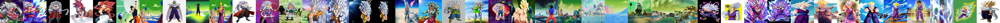

In [15]:
def image_grid(imgs, rows, cols):
    assert len(imgs) == rows*cols

    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid
image_grid(img, 1, len(img))

In [16]:
import csv
data = []  # Danh sách để lưu trữ dữ liệu

with open(promt_path, 'r') as file:
    reader = csv.reader(file)
    for row in reader:
        # Xử lý dữ liệu trên mỗi dòng
        text = ",".join(row)  # Kết hợp tất cả các trường thành một đoạn văn bản

        # Thêm dữ liệu vào danh sách
        data.append(text)

# In kết quả
for text in data:
    print(text)


name, prompt
1, "Songoku, super saiyan five"
2, "Songoku, super saiyan five, Demon clothe"
3, "Songoku, super saiyan five"
4, "Songoku, red hair, female"
5, "Songoku, red hair, female"
6, "Songoku, Namek planet background"
7, "Namek planet background"
8, "Demon clothe"
9, "Demon clothe, Namek planet background"
10, "Demon clothe, Namek planet background"
11, "Demon clothe"
12, "Songoku, Namek planet background"
13, "Demon clothe"
14, "super saiyan five, songoku"
15, "super saiyan five, songoku"
16, "super saiyan five, songoku, Demon clothe"
17, "Demon clothe"
18, "super saiyan five, songoku"
19, "Namek planet background, background detailed"
20, "Namek planet background, background detailed"
21, "Namek planet background, background detailed"
22, "super saiyan five, Demon clothe"
23, "Demon clothe"
24, "Demon clothe"
25, "Demon clothe"
26, "Namek planet background"
27, "Super saiyan five, songoku"
28, "Namek planet background"
29, "songoku, Namek planet background"
30, "songoku, Namek p

In [17]:
prompt_data = data[1::]
prompt_data_splited = []
for promt_order in prompt_data:
  prompt_data_splited.append(promt_order.split('"'))
prompt_data_splited[-1][0]

'43, '

In [18]:
# img_names
img_prompts = []

for i in range(len(img_names)):
  img_prompt = prompt_data_splited[int(img_names[i])-1][1]
  img_prompts.append(img_prompt)


In [19]:
img_prompts_np = np.array(img_prompts)
img_prompts_np.shape

(43,)

In [97]:
img_np = np.array(img)
img_np.shape

<ipython-input-97-8f08fab379dc>:1: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  img_np = np.array(img)
<ipython-input-97-8f08fab379dc>:1: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  img_np = np.array(img)


(43,)

In [20]:
captions = []
for caption in img_prompts[0][:]:
  # print(caption)
  captions.append(caption)
inputs = tokenizer(
            captions, max_length=tokenizer.model_max_length, padding="max_length", truncation=True, return_tensors="pt"
        )
inputs.input_ids

tensor([[49406,   338, 49407,  ..., 49407, 49407, 49407],
        [49406,   334, 49407,  ..., 49407, 49407, 49407],
        [49406,   333, 49407,  ..., 49407, 49407, 49407],
        ...,
        [49406,   328, 49407,  ..., 49407, 49407, 49407],
        [49406,   341, 49407,  ..., 49407, 49407, 49407],
        [49406,   324, 49407,  ..., 49407, 49407, 49407]])

In [ ]:
tokenizer

In [99]:

inputs = tokenizer(
          img_prompts[0], max_length=tokenizer.model_max_length, padding="max_length", truncation=True, return_tensors="pt"
        )
text_tensor = inputs.input_ids
# text_tensor = text_tensor.flatten()
text_tensor.shape

torch.Size([1, 77])

In [126]:
torch.cuda.empty_cache()
!nvidia-smi

Thu Jul 13 20:35:01 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA A100-SXM...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   34C    P0    51W / 400W |  40503MiB / 40960MiB |      0%      Default |
|                               |                      |             Disabled |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [21]:
class ImgDataset(Dataset):
  def __init__(
    self,
    img_dir,
    img_prompts,
    tokenizer,
    size = 512,
    center_crop=False
  ):
    self.size = size
    self.center_crop = center_crop
    self.tokenizer = tokenizer
    self.img_dir = img_dir
    self.num_images = len(self.img_dir)
    self.img_prompts = img_prompts
    self._length = self.num_images
    self.image_transforms = transforms.Compose(
            [
                transforms.Resize(size, interpolation=transforms.InterpolationMode.BILINEAR),
                transforms.CenterCrop(size) if center_crop else transforms.RandomCrop(size),
                transforms.ToTensor(),
                transforms.Normalize([0.5], [0.5]),
            ]
        )
  def __len__(self):
      return self._length

  def __getitem__(self, index):
    example = {}
    image = Image.open(self.img_dir[index % self.num_images])
    if not image.mode == "RGB":
      image = image.convert("RGB")
    example["images"]= self.image_transforms(image)

    prompt = img_prompts[index % self.num_images]
    inputs = self.tokenizer(
      prompt, max_length=tokenizer.model_max_length, padding="max_length", truncation=True, return_tensors="pt"
    )
    example["image_prompts"] = inputs.input_ids.flatten()
    return example

In [22]:
def collate_fn(examples):
  pixel_values = torch.stack([example["images"] for example in examples])
  pixel_values = pixel_values.to(memory_format=torch.contiguous_format).float()
  prompts = torch.stack([example["image_prompts"] for example in examples])
  return {"images": pixel_values, "image_prompts": prompts}

In [ ]:
img_prompts


In [23]:
with accelerator.main_process_first():
  train_dataset = ImgDataset(
      img_dir = image_path_list,
      img_prompts = img_prompts,
      tokenizer = tokenizer,
      center_crop = center_crop
  )
  train_dataloader = DataLoader(
      train_dataset,
      batch_size = train_batch_size,
      collate_fn = collate_fn,
      num_workers = num_workers
  )

#Khởi tạo thông số trainning, khởi tạo hàm loss

**lập lịch và tính toán xung quanh số bước đào tạo**

In [24]:
def compute_snr(timesteps):
  alphas_cumprod = scheduler.alphas_cumprod
  sqrt_alphas_cumprod = alphas_cumprod**0.5
  sqrt_one_minus_alphas_cumprod = (1.0 - alphas_cumprod) ** 0.5

  sqrt_alphas_cumprod = sqrt_alphas_cumprod.to(device=timesteps.device)[timesteps].float()
  while len(sqrt_alphas_cumprod.shape) < len(timesteps.shape):
      sqrt_alphas_cumprod = sqrt_alphas_cumprod[..., None]
  alpha = sqrt_alphas_cumprod.expand(timesteps.shape)
  sqrt_one_minus_alphas_cumprod = sqrt_one_minus_alphas_cumprod.to(device=timesteps.device)[timesteps].float()
  while len(sqrt_one_minus_alphas_cumprod.shape) < len(timesteps.shape):
      sqrt_one_minus_alphas_cumprod = sqrt_one_minus_alphas_cumprod[..., None]
  sigma = sqrt_one_minus_alphas_cumprod.expand(timesteps.shape)
  # Compute SNR.
  snr = (alpha / sigma) ** 2
  return snr

In [ ]:
# import xformers
# unet.enable_xformers_memory_efficient_attention()

In [55]:
import itertools
# params_to_optimize = itertools.chain(
#     unet_lora_parameters,
#     text_encoder.parameters()
# )
# params_to_optimize = unet_lora_parameters
lora_layers = AttnProcsLayers(unet.attn_processors)
lora_layers.train()
lora_layers.to(accelerator.device, dtype=weight_dtype)

params_to_optimize = itertools.chain(
    lora_layers.parameters(),
    controlnet.parameters()
)

In [56]:
learning_rate = (
            learning_rate * gradient_accumulation_steps * train_batch_size * accelerator.num_processes
        )

optimizer_cls = torch.optim.AdamW
optimizer = optimizer_cls(
#   lora_layers.parameters(),
#   unet.parameters(),
  params_to_optimize,
  lr=learning_rate,
  betas=(adam_beta1, adam_beta2),
  weight_decay=adam_weight_decay,
  eps=adam_epsilon,
)

In [57]:
num_update_steps_per_epoch = math.ceil(len(train_dataloader) / gradient_accumulation_steps)
lr_scheduler = get_scheduler(
  lr_scheduler,
  optimizer=optimizer,
  num_warmup_steps=lr_warmup_steps * gradient_accumulation_steps,
  num_training_steps=max_train_steps * gradient_accumulation_steps,
)

In [58]:
lora_layers, controlnet, optimizer, train_dataloader, lr_scheduler = accelerator.prepare(
  lora_layers, controlnet, optimizer, train_dataloader, lr_scheduler
)
num_update_steps_per_epoch = math.ceil(len(train_dataloader) / gradient_accumulation_steps)
num_train_epochs = math.ceil(max_train_steps / num_update_steps_per_epoch)
logger = get_logger(__name__, log_level="INFO")
resume_from_checkpoint = None
weight_dtype = torch.float32

In [59]:
noise_offset = 0
snr_gamma = 5.0
checkpointing_steps = 500


In [ ]:
len(img_prompts)

In [60]:
# validation_prompt = img_prompts[np.random.randint(0, 16)]
num_validation_images = 4
validation_epochs = 1
loss_list = []
training_loss_list= []

In [61]:
def train(
    resume_from_checkpoint = None,
    train_dataset = train_dataset,
    num_train_epochs = num_train_epochs,
    train_batch_size= train_batch_size,
    gradient_accumulation_steps = gradient_accumulation_steps,
    max_train_steps = max_train_steps,
    output_dir = output_dir,
    control_output = control_output,
    num_update_steps_per_epoch = num_update_steps_per_epoch,
    train_dataloader = train_dataloader,
    weight_dtype = weight_dtype,
    noise_offset = noise_offset,
    vae = vae,
    unet = unet,
    controlnet = controlnet,
    scheduler = scheduler,
    text_encoder = text_encoder,
    snr_gamma = snr_gamma,
    checkpointing_steps = checkpointing_steps,
    revision = None,
    seed = seed,
    # validation_prompt = validation_prompt,
    num_validation_images = num_validation_images,
    validation_epochs = validation_epochs,
    loss_list = loss_list,
    training_loss_list= training_loss_list,
    checkpoints_total_limit = None

  ):
  total_batch_size = train_batch_size * accelerator.num_processes * gradient_accumulation_steps
  logger.info("***** Running training *****")
  logger.info(f"  Num examples = {len(train_dataset)}")
  logger.info(f"  Num Epochs = {num_train_epochs}")
  logger.info(f"  Instantaneous batch size per device = {train_batch_size}")
  logger.info(f"  Total train batch size (w. parallel, distributed & accumulation) = {total_batch_size}")
  logger.info(f"  Gradient Accumulation steps = {gradient_accumulation_steps}")
  logger.info(f"  Total optimization steps = {max_train_steps}")
  global_step = 0
  first_epoch = 0
  validation_prompt = ''
  print("pas0")

  if resume_from_checkpoint:
    if resume_from_checkpoint != "latest":
      path = os.path.basename(resume_from_checkpoint)
      print(path)
    else:
      # Get the most recent checkpoint
      dirs = os.listdir(output_dir)
      dirs = [d for d in dirs if d.startswith("checkpoint")]
      dirs = sorted(dirs, key=lambda x: int(x.split("-")[1]))
      path = dirs[-1] if len(dirs) > 0 else None
      print(path)

    if path is None:
      print("pas2")
      accelerator.print(
        f"Checkpoint '{resume_from_checkpoint}' does not exist. Starting a new training run."
      )
      resume_from_checkpoint = None
    else:
      accelerator.print(f"Resuming from checkpoint {path}")
      print(f"Resuming from checkpoint {path}")
      accelerator.load_state(os.path.join(output_dir, path))
      # accelerator.load_stDate(path)
      global_step = int(path.split("-")[1])
      resume_global_step = global_step * gradient_accumulation_steps
      first_epoch = global_step // num_update_steps_per_epoch
      resume_step = resume_global_step % (num_update_steps_per_epoch * gradient_accumulation_steps)


  print("pass")
  progress_bar = tqdm(range(global_step, max_train_steps), disable=not accelerator.is_local_main_process)
  progress_bar.set_description("Steps")

  for epoch in range(first_epoch, num_train_epochs):
    # validation_prompt = img_prompts[np.random.randint(0,9)]
    unet.train()
    train_loss = 0.0
    for step, batch in enumerate(train_dataloader):
      if resume_from_checkpoint and epoch == first_epoch and step < resume_step:
        if step % gradient_accumulation_steps == 0:
          progress_bar.update(1)
        continue

      with accelerator.accumulate(unet):
        # Convert images to latent space
        latents = (vae.encode(batch["images"].to(dtype=weight_dtype)).latent_dist.sample()).to(dtype=weight_dtype)
        latents = latents * vae.config.scaling_factor
        noise = torch.randn_like(latents)
        if noise_offset:
          noise += noise_offset * torch.randn(
            (latents.shape[0], latents.shape[1], 1, 1), device=latents.device
          )
        bsz = latents.shape[0]
        timesteps = torch.randint(0, scheduler.config.num_train_timesteps, (bsz,), device=latents.device)
        timesteps = timesteps.long()

        noisy_latents = scheduler.add_noise(latents, noise, timesteps)

        encoder_hidden_states = text_encoder(batch["image_prompts"])[0]
        target = noise.requires_grad_()
        controlnet_image = batch["images"].to(dtype=weight_dtype)

        down_block_res_samples, mid_block_res_sample = controlnet(
                    noisy_latents,
                    timesteps,
                    encoder_hidden_states=encoder_hidden_states,
                    controlnet_cond=controlnet_image,
                    return_dict=False,
                )

        model_pred = unet(
            noisy_latents,
            timesteps,
            encoder_hidden_states,
            down_block_additional_residuals=[
                sample.to(dtype=weight_dtype) for sample in down_block_res_samples
                ],
                mid_block_additional_residual=mid_block_res_sample.to(dtype=weight_dtype)
        ).sample

        model_pred = model_pred.requires_grad_()
        snr = compute_snr(timesteps)
        mse_loss_weights = (
          torch.stack([snr, snr_gamma * torch.ones_like(timesteps)], dim=1).min(dim=1)[0] / snr
        )
        loss = F.mse_loss(model_pred.float(), target.float(), reduction="none")
        loss = loss.mean(dim=list(range(1, len(loss.shape)))) * mse_loss_weights
        loss = loss.mean()
        loss_list.append(loss)
        # Gather the losses across all processes for logging (if we use distributed training).
        avg_loss = accelerator.gather(loss.repeat(train_batch_size)).mean()
        train_loss += avg_loss.item() / gradient_accumulation_steps
        training_loss_list.append(train_loss)
        # Backpropagate
        accelerator.backward(loss)
        if accelerator.sync_gradients:
            params_to_clip = lora_layers.parameters()
            accelerator.clip_grad_norm_(params_to_clip, max_grad_norm)
        optimizer.step()
        lr_scheduler.step()
        optimizer.zero_grad()
        # Checks if the accelerator has performed an optimization step behind the scenes
      if accelerator.sync_gradients:
        progress_bar.update(1)
        global_step += 1
        accelerator.log({"train_loss": train_loss}, step=global_step)
        train_loss = 0.0
        if global_step % checkpointing_steps == 0:

          if accelerator.is_main_process:

            if checkpoints_total_limit is not None:
              checkpoints = os.listdir(output_dir)
              checkpoints = [d for d in checkpoints if d.startswith("checkpoint")]
              checkpoints = sorted(checkpoints, key=lambda x: int(x.split("-")[1]))

              # before we save the new checkpoint, we need to have at _most_ `checkpoints_total_limit - 1` checkpoints
              if len(checkpoints) >= checkpoints_total_limit:
                num_to_remove = len(checkpoints) - checkpoints_total_limit + 1
                removing_checkpoints = checkpoints[0:num_to_remove]
                logger.info(
                  f"{len(checkpoints)} checkpoints already exist, removing {len(removing_checkpoints)} checkpoints"
                )
                logger.info(f"removing checkpoints: {', '.join(removing_checkpoints)}")

                for removing_checkpoint in removing_checkpoints:
                  removing_checkpoint = os.path.join(output_dir, removing_checkpoint)
                  shutil.rmtree(removing_checkpoint)

            save_path = os.path.join(output_dir, f"checkpoint-{global_step}")
            accelerator.save_state(save_path)
            print((f"Saved state to {save_path}"))
            logger.info(f"Saved state to {save_path}")
      logs = {"step_loss": loss.detach().item(), "lr": lr_scheduler.get_last_lr()[0]}
      progress_bar.set_postfix(**logs)
      if global_step >= max_train_steps:
        break
    # if accelerator.is_main_process:
    #   if validation_prompt is not None and epoch % validation_epochs == 0:
    #     logger.info(
    #       f"Running validation... \n Generating {num_validation_images} images with prompt:"
    #       f" {validation_prompt}."
    #     )
    #     # create pipeline
    #     pipeline = StableDiffusionPipeline.from_pretrained(
    #       "converted",
    #       unet= accelerator.unwrap_model(unet),
    #       revision=revision,
    #       torch_dtype=weight_dtype,
    #       safety_checker=None
    #     )
        # pipeline = pipeline.to(accelerator.device)
        # pipeline.set_progress_bar_config(disable=True)
        # # run inference
        # generator = torch.Generator(device=accelerator.device)
        # if seed is not None:
        #     generator = generator.manual_seed(seed)
        # images = []
        # for _ in range(num_validation_images):
        #   images.append(
        #     pipeline(validation_prompt, num_inference_steps=30, generator=generator).images[0]
        #   )

        # pipeline.save_lora_weights(output_dir)
        # pipeline.save_pretrained(output_dir)
        # pipeline.save_config(output_dir)

        # for tracker in accelerator.trackers:
        #   if tracker.name == "tensorboard":
        #       np_images = np.stack([np.asarray(img) for img in images])
        #       tracker.writer.add_images("validation", np_images, epoch, dataformats="NHWC")
        # del pipeline
        # torch.cuda.empty_cache()
  # Save the lora layers
  accelerator.wait_for_everyone()
  if accelerator.is_main_process:
    # unet = accelerator.unwrap_model(unet)
    # unet = unet.to(torch.float32)
    # unet.save_config(output_dir)
    # unet_lora_layers = unet_attn_processors_state_dict(unet)
    # LoraLoaderMixin.save_lora_weights(
    #         save_directory= output_dir,
    #         unet_lora_layers = lora_layers
    #         # unet_lora_layers=unet_lora_layers,
    #         # text_encoder_lora_layers=text_encoder_lora_layers,
    #     )

    controlnet = accelerator.unwrap_model(controlnet)
    controlnet.save_pretrained(control_output)
    # pipe.unet = unet
    # pipe.text_encoder = text_encoder
    # pipe.save_pretrained(output_dir)
    # pipe.save_config(output_dir)


  accelerator.end_training()






In [62]:
train()

INFO:__main__:***** Running training *****
INFO:__main__:  Num examples = 43
INFO:__main__:  Num Epochs = 1
INFO:__main__:  Instantaneous batch size per device = 1
INFO:__main__:  Total train batch size (w. parallel, distributed & accumulation) = 4
INFO:__main__:  Gradient Accumulation steps = 4
INFO:__main__:  Total optimization steps = 10


pas0
pass


  0%|          | 0/10 [00:00<?, ?it/s]

In [63]:
torch.cuda.empty_cache()
!nvidia-smi

Thu Jul 13 21:03:17 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA A100-SXM...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   37C    P0    53W / 400W |  25433MiB / 40960MiB |      2%      Default |
|                               |                      |             Disabled |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [38]:
"Songoku, red hair, female, Demon clothe, Namek planet background, Super saiyan 5"
controlitf = ControlNetModel.from_pretrained(output_dir)

In [64]:
controlitf = ControlNetModel.from_pretrained(control_output, torch_dtype=weight_dtype)
# controlitf =  ControlNetModel.from_pretrained("lllyasviel/sd-controlnet-scribble")
pipeline = StableDiffusionControlNetPipeline.from_pretrained(
            # output_dir,
            "converted",
            scheduler=scheduler,
            controlnet = controlitf,
            safety_checker=None,
            torch_dtype=weight_dtype
        )
pipeline = pipeline.to(accelerator.device)
# pipeline.unet.load_attn_procs(output_dir)
# pipeline.text_encoder = text_encoder

You have disabled the safety checker for <class 'diffusers.pipelines.controlnet.pipeline_controlnet.StableDiffusionControlNetPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


In [65]:
pipeline.unet.load_attn_procs(output_dir)

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

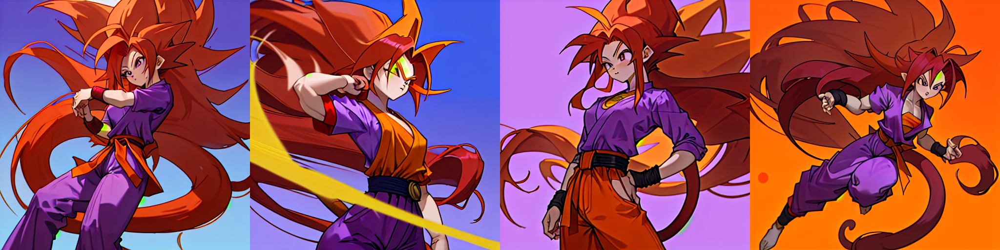

In [119]:
from diffusers.utils import load_image
torch.no_grad()
validation_prompt = "songoku, super saiyan five, red hair, female, Namek planet background,(masterpiece), (((best quality))), super long hair, monkey hair and tail, purple shirt, purple pants, red belt, untie spiky hair, monkey girl, lots of hair, blue background"
# validation_prompt= "songoku, blue background"
seed = np.random.randint(0,1000)

generator = torch.Generator(device=accelerator.device)
if seed is not None:
  generator = generator.manual_seed(seed)
images = []
for _ in range(num_validation_images):
  controlimg = load_image("/content/drive/MyDrive/Stable_diffusion/check/14.jpg")
  images.append(pipeline(validation_prompt, num_inference_steps=100, generator=generator, image=controlimg, height=512, width= 512).images[0])
  torch.cuda.empty_cache()
if accelerator.is_main_process:
    for tracker in accelerator.trackers:
        if len(images) != 0:
            if tracker.name == "tensorboard":
                np_images = np.stack([np.asarray(img) for img in images])
                tracker.writer.add_images("test", np_images, 10, dataformats="NHWC")

image_grid(images, 1, len(images))


In [66]:
!nvidia-smi

Thu Jul 13 19:50:45 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA A100-SXM...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   35C    P0    51W / 400W |  21553MiB / 40960MiB |      0%      Default |
|                               |                      |             Disabled |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

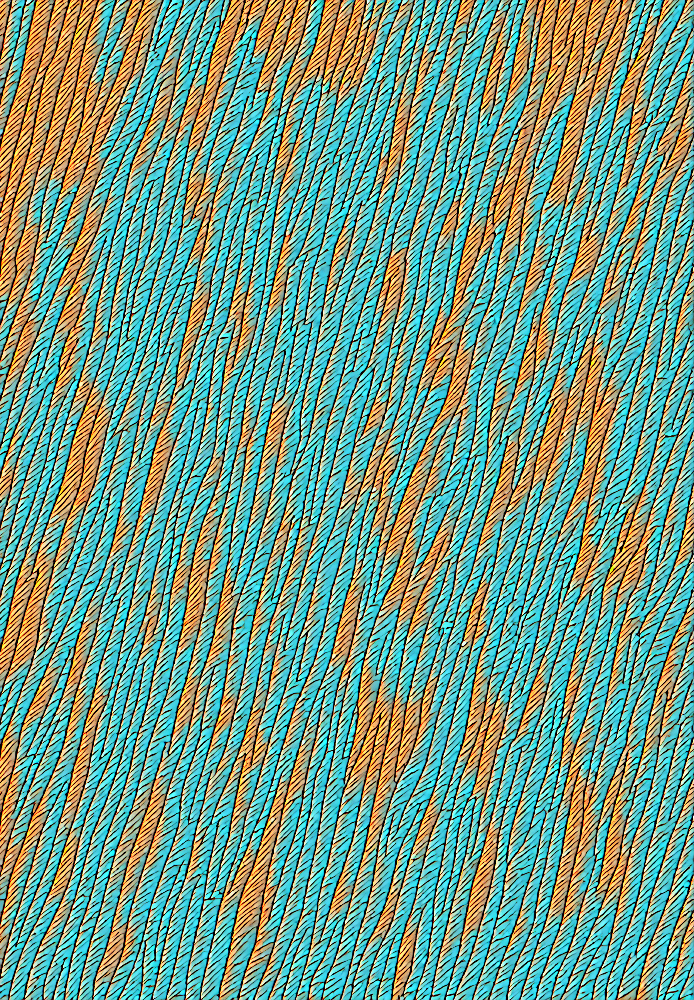

In [80]:
images[2].show()

In [78]:
image_grid(images, 1, len(images))

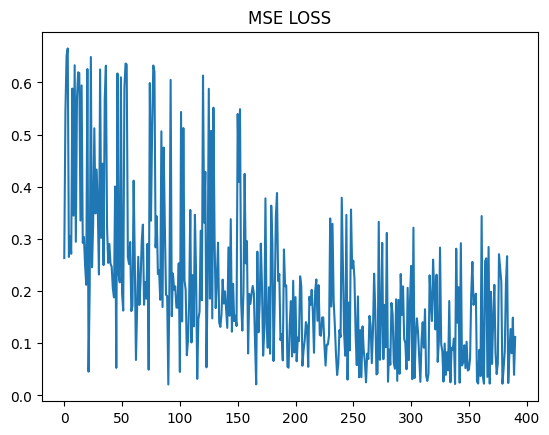

In [62]:
xll = np.arange(len(loss_list))
yll = np.array(torch.Tensor(loss_list).cpu().numpy())
plt.plot(xll, yll)
plt.title("MSE LOSS")
plt.show()

In [ ]:
xtll = np.arange(len(training_loss_list))
ytll = np.array(torch.Tensor(training_loss_list).cpu().numpy())
plt.plot(xtll, ytll)
plt.title("BATCH LOSS")
plt.show()

\